In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.insert(0, '/lab/solexa_weissman/kmin/git/spateo-release')

import matplotlib.pyplot as plt
import numpy as np
import skimage
import sklearn
import spateo as st

plt.style.use('default')
plt.rcParams['image.interpolation'] = 'none'
%config InlineBackend.figure_format='retina'

/pub/data/zhangx/jingzh/miniconda3/envs/spateo/lib/python3.8/site-packages/geopandas-0.10.2-py3.8.egg/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(
/pub/data/zhangx/jingzh/miniconda3/envs/spateo/lib/python3.8/site-packages/dynamo_release-1.0.0-py3.8.egg/dynamo/configuration.py:60: UserWarning: Trying to register the cmap 'fire' which already exists.
  plt.register_cmap("fire", fire_cmap)
/pub/data/zhangx/jingzh/miniconda3/envs/spateo/lib/python3.8/site-packages/dynamo_release-1.0.0-py3.8.egg/dynamo/configuration.py:61: UserWarning: Trying to register the cmap 'darkblue' which already exists.
  plt.register_cmap("darkblue", darkblue_cmap)
/pub/data/zhangx/jingzh/miniconda3/envs/spateo/lib/python3.8/site-packages/dynamo_release-1.0.0-py3.8.egg/dynamo/configuration.py:62: UserWarning: Trying to register the cmap

In [2]:
mtx_path = "matrix.txt.gz"
tif_path = "ssDNA.tif"

In [3]:
%%time
adata = st.io.read_bgi_agg(
    mtx_path,
    tif_path,
    scale=0.5,
    scale_unit='um',
    gene_agg={'nuclear': ['Malat1']}
).copy()
adata

CPU times: user 1min 26s, sys: 12.5 s, total: 1min 38s
Wall time: 1min 38s


AnnData object with n_obs × n_vars = 10509 × 13646
    uns: '__type', 'pp', 'spatial'
    layers: 'stain', 'spliced', 'unspliced', 'nuclear'

In [4]:
st.pp.segmentation.select_qc_regions(adata, seed=0)
adata.uns['spatial']['qc']

array([[ 6000,  8000,  2000,  4000],
       [ 8000, 10000,  4000,  6000],
       [ 4000,  6000,  8000, 10000],
       [ 4000,  6000,  6000,  8000]])

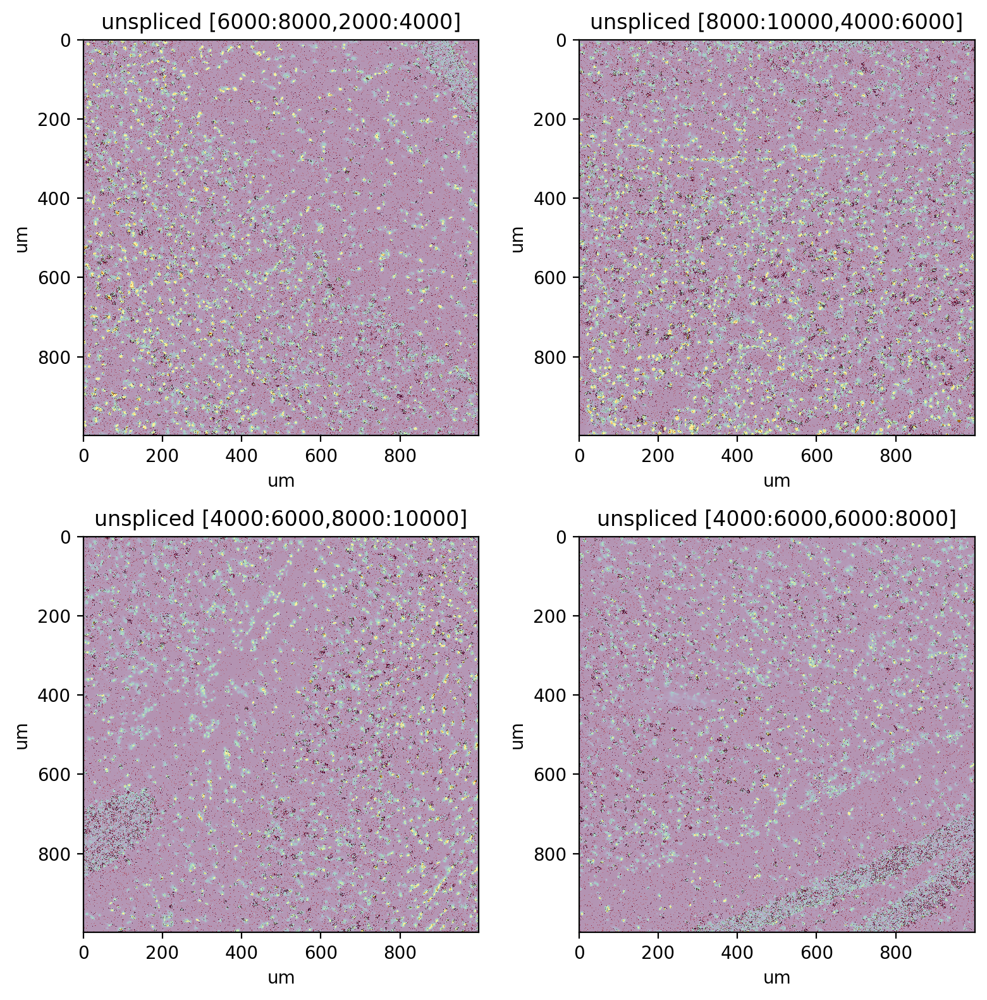

In [5]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced', axes=axes, vmax=3, alpha=0.6, cmap='Reds')

## Stain

In [6]:
%%time
st.pp.segmentation.refine_alignment(adata, mode='rigid', transform_layers=['stain'], downscale=0.5)

Loss -2.7994e-03: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [10:09<00:00,  6.10s/it]


CPU times: user 1h 2min 15s, sys: 1h 32s, total: 2h 2min 48s
Wall time: 10min 28s


In [7]:
%%time
st.pp.segmentation.mask_nuclei_from_stain(adata)
st.pp.segmentation.watershed_markers(adata)
st.pp.segmentation.watershed(adata)

CPU times: user 3min 28s, sys: 4min 4s, total: 7min 32s
Wall time: 1min 4s


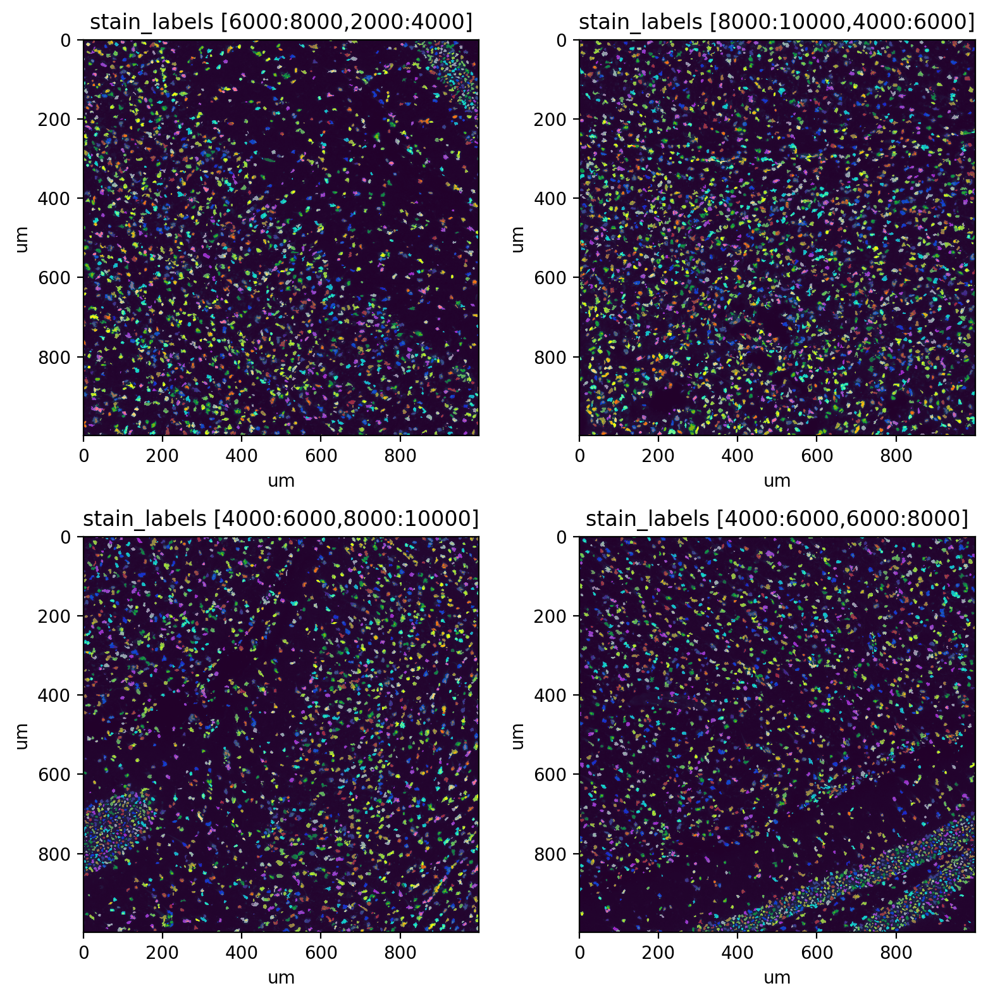

In [8]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'stain_labels', axes=axes, alpha=0.5, labels=True)

In [9]:
%%time
st.pp.segmentation.mask_cells_from_stain(adata, out_layer='stain_cell_mask')
st.pp.segmentation.watershed(
    adata,
    mask_layer='stain_cell_mask',
    markers_layer='stain_labels',
    out_layer='cell_labels',
)

CPU times: user 1min 10s, sys: 8.43 s, total: 1min 19s
Wall time: 1min 19s


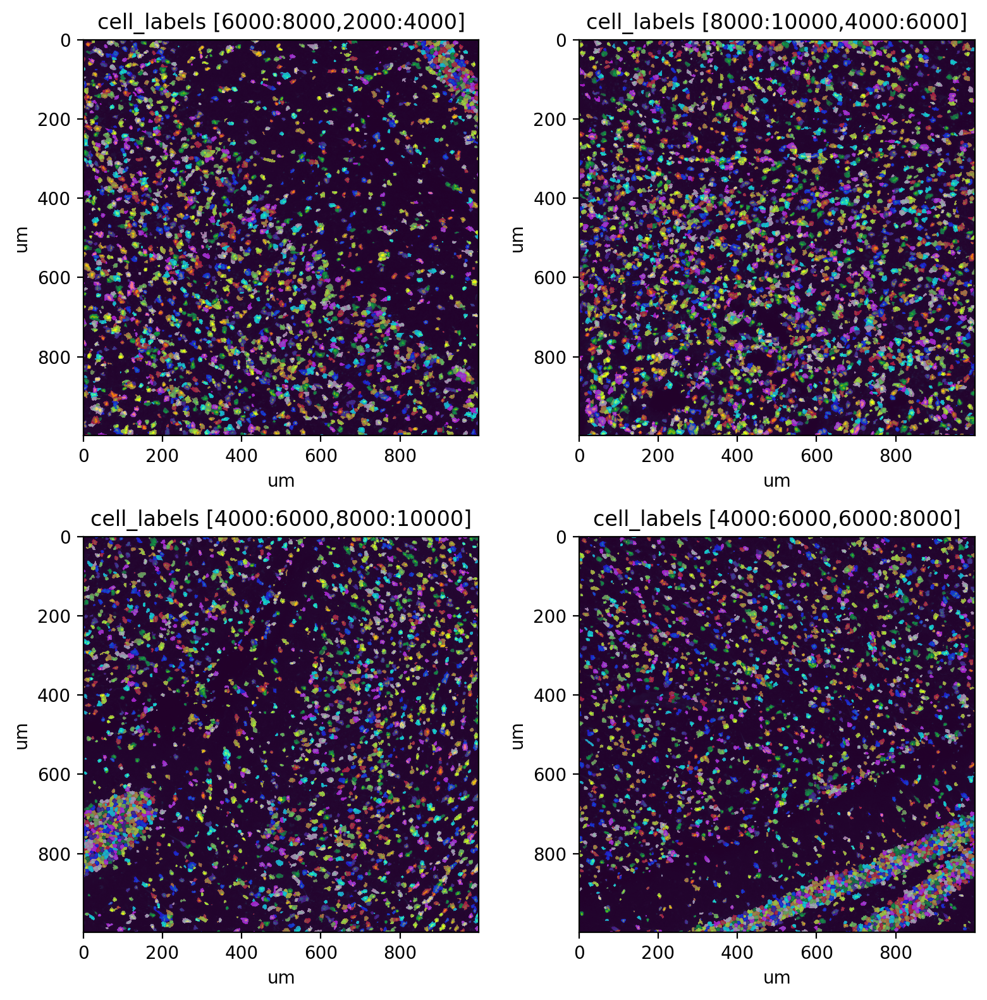

In [10]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels', axes=axes, alpha=0.5, labels=True)

In [11]:
%%time
st.pp.segmentation.expand_labels(adata, 'cell_labels', distance=2, max_area=np.inf, out_layer='cell_labels_expanded')

CPU times: user 10min 9s, sys: 5.9 s, total: 10min 15s
Wall time: 10min 12s


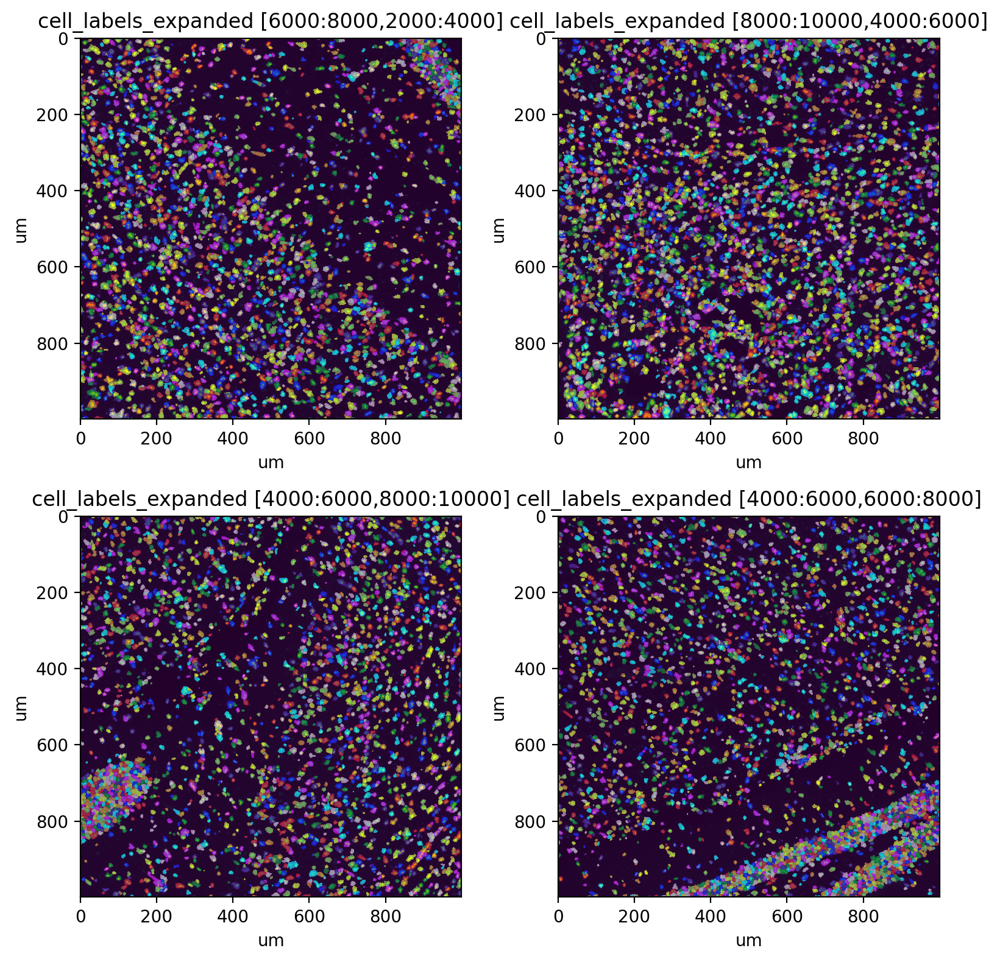

In [12]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'cell_labels_expanded', axes=axes, alpha=0.5, labels=True)

## RNA

In [13]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'nuclear', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001), bp_kwargs=dict(n_threads=16),
    mk=3  # Expected to be small
)
st.pp.segmentation.label_connected_components(adata, 'nuclear')

Running EM: 100%|#####################################################################################################################################| 1/1 [03:29<00:00, 209.13s/it]


CPU times: user 20min 39s, sys: 6min 49s, total: 27min 29s
Wall time: 11min 5s


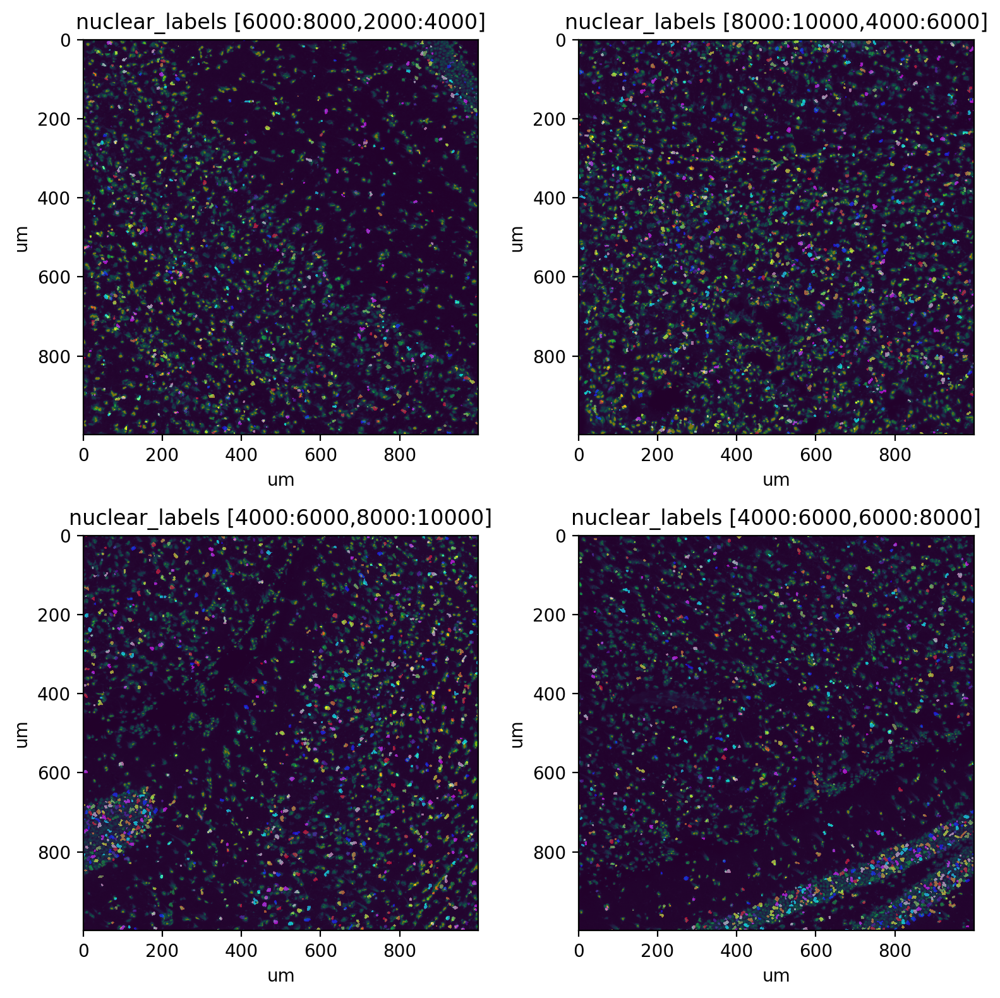

In [14]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'nuclear_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 49.4 s, sys: 21 s, total: 1min 10s
Wall time: 59.1 s


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'unspliced_bins'}, xlabel='um', ylabel='um'>)

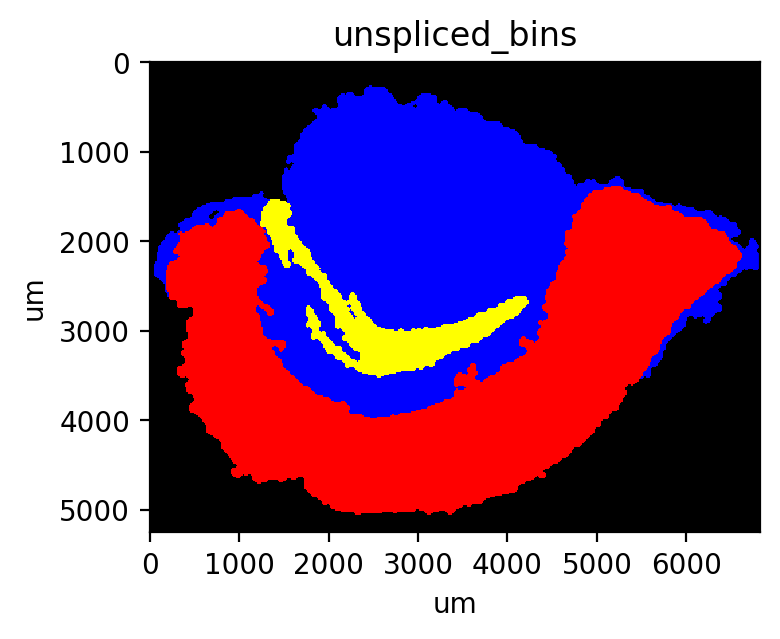

In [15]:
%%time
st.pp.segmentation.segment_densities(adata, 'unspliced', 30, k=5, dk=3, distance_threshold=4)
st.pl.imshow(adata, 'unspliced_bins', labels=True)

In [16]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'unspliced', k=13, method='EM+BP',
    em_kwargs=dict(downsample=0.001), bp_kwargs=dict(n_threads=16),
    certain_layer='nuclear_labels'
)
st.pp.segmentation.label_connected_components(adata, 'unspliced', seed_layer='nuclear_labels')

Running EM: 100%|######################################################################################################################################| 3/3 [00:56<00:00, 18.80s/it]


CPU times: user 28min 9s, sys: 6min 28s, total: 34min 37s
Wall time: 14min 28s


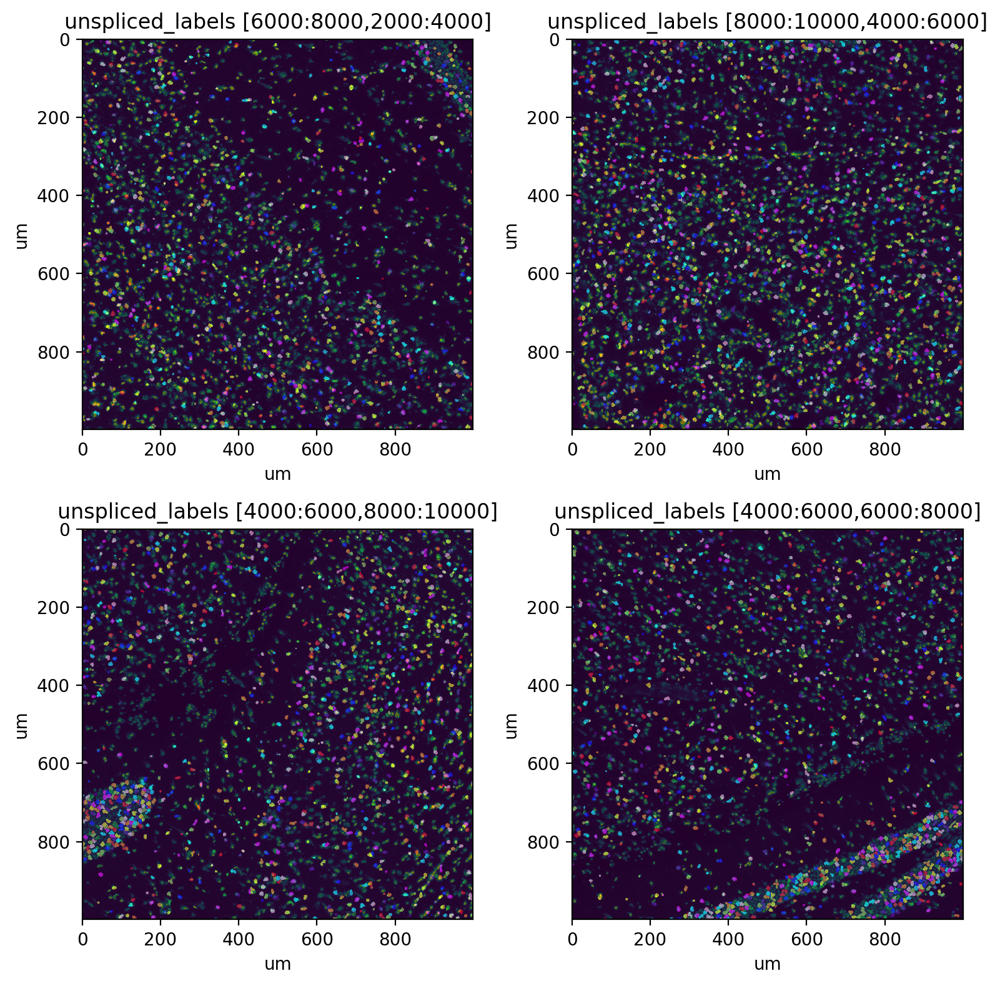

In [17]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'unspliced_labels', axes=axes, alpha=0.5, labels=True)

CPU times: user 9min 26s, sys: 44.6 s, total: 10min 10s
Wall time: 10min


(<Figure size 400x400 with 1 Axes>,
 <AxesSubplot:title={'center':'X_bins'}, xlabel='um', ylabel='um'>)

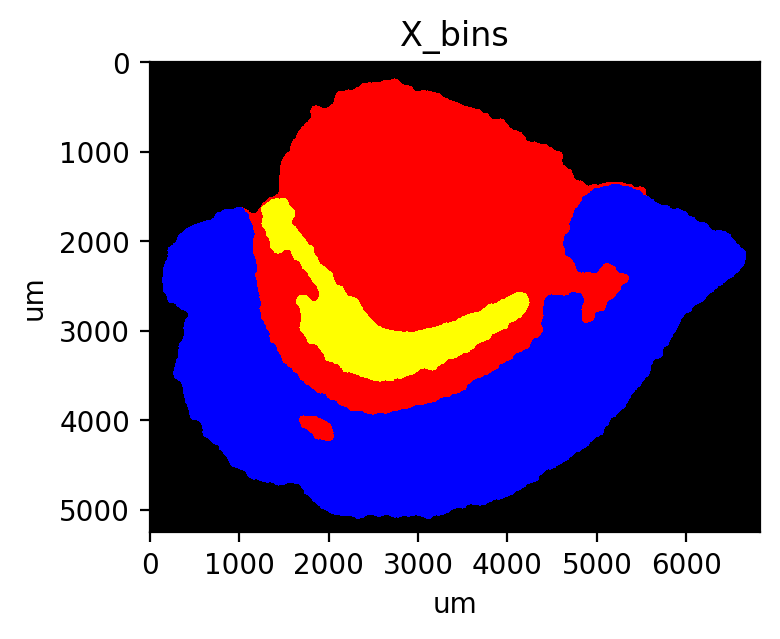

In [21]:
%%time
st.pp.segmentation.segment_densities(adata, 'X', 10, k=5, distance_threshold=20, dk=21)
st.pl.imshow(adata, 'X_bins', labels=True)

In [22]:
%%time
st.pp.segmentation.score_and_mask_pixels(
    adata, 'X', k=15, method='EM+BP',
    em_kwargs=dict(downsample=0.001, seed=2022), bp_kwargs=dict(n_threads=16),
    certain_layer='unspliced_labels'
)
st.pp.segmentation.expand_labels(
    adata, 'unspliced', distance=5, max_area=400, mask_layer='X_mask', out_layer='X_labels'
)

Running EM: 100%|######################################################################################################################################| 3/3 [02:24<00:00, 48.28s/it]


CPU times: user 52min 19s, sys: 3min 35s, total: 55min 55s
Wall time: 43min 19s


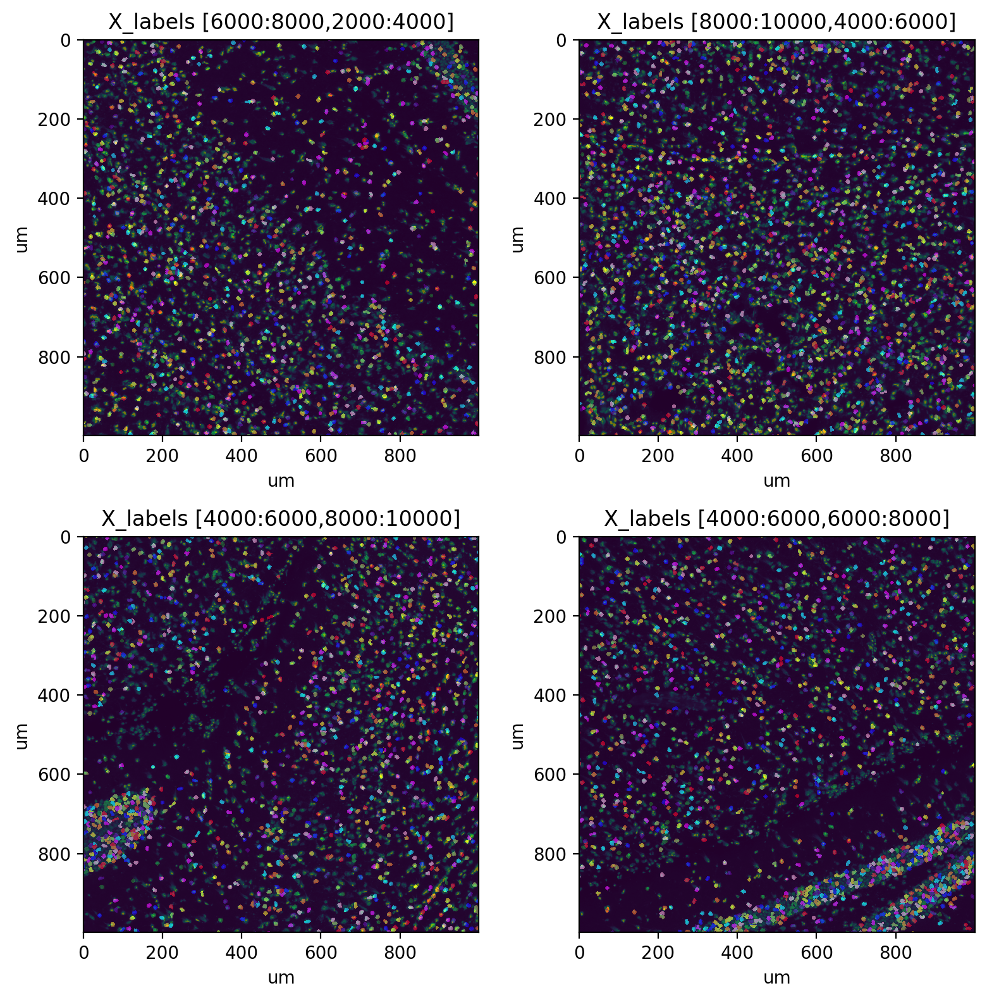

In [23]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels', axes=axes, alpha=0.5, labels=True)

In [24]:
%%time
st.pp.segmentation.expand_labels(adata, 'X', distance=2, max_area=np.inf, out_layer='X_labels_expanded')

CPU times: user 11min 49s, sys: 18 s, total: 12min 7s
Wall time: 12min 3s


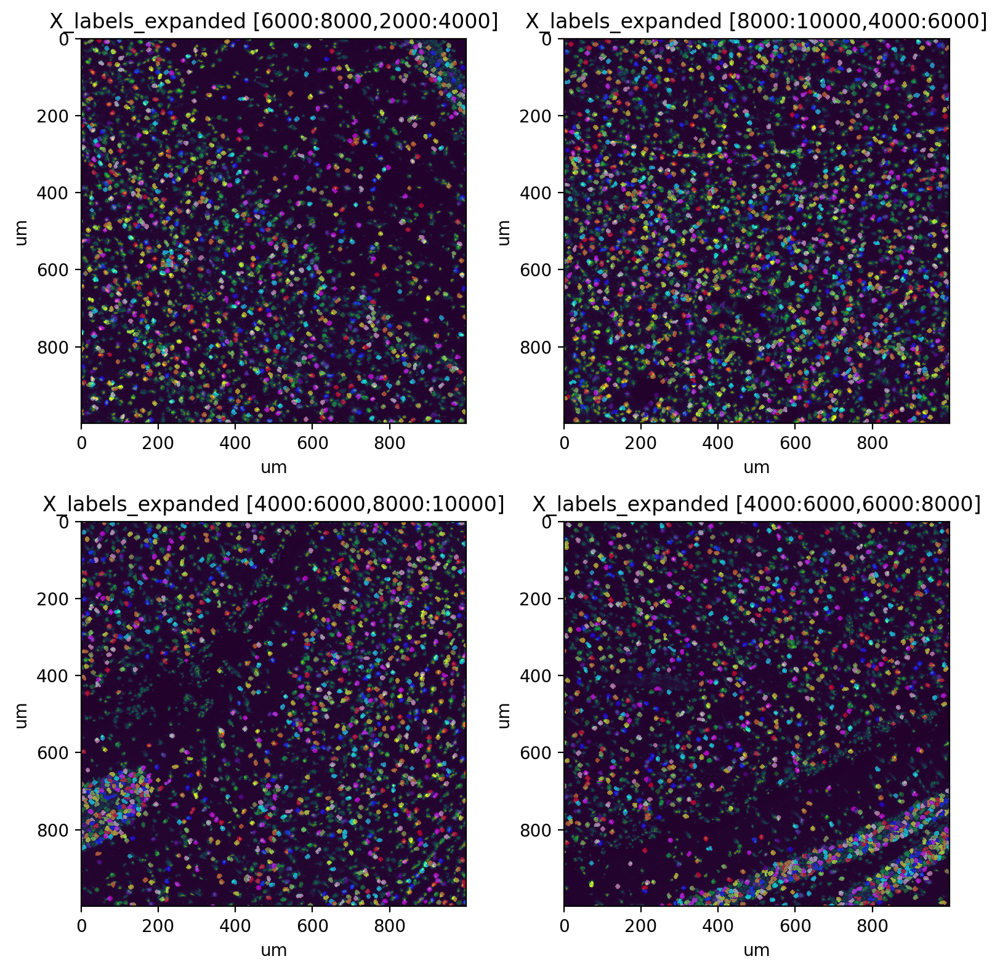

In [25]:
fig, axes = st.pl.qc_regions(adata, 'stain', ncols=2)
st.pl.qc_regions(adata, 'X_labels_expanded', axes=axes, alpha=0.5, labels=True)

In [26]:
adata.write('full_segmentation.h5ad', compression='gzip')